In [1]:
! pip install pillow

In [2]:
from PIL import Image
from matplotlib import pyplot as plt
import cv2

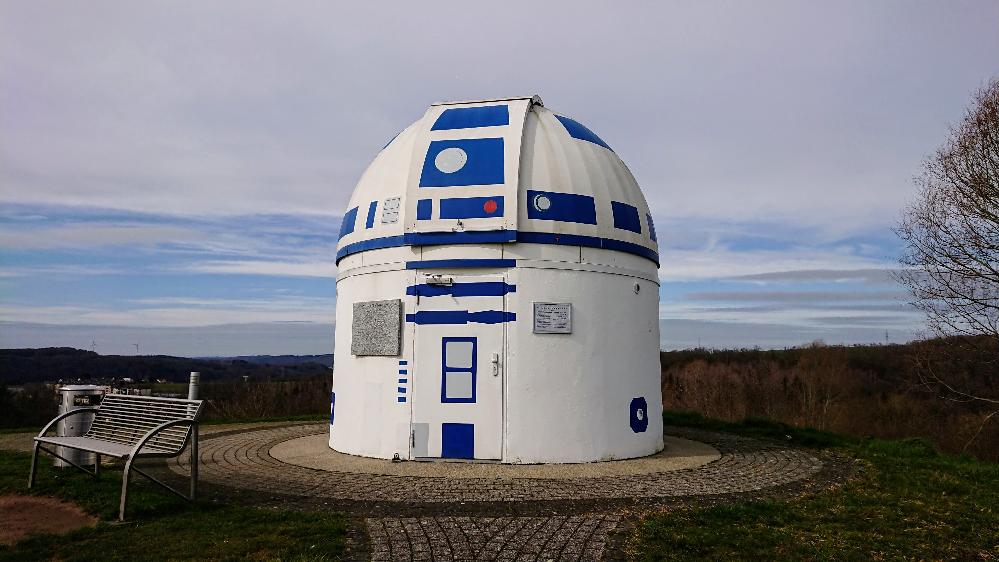

In [3]:
img_large = Image.open('r2d2.jpg')
img_large

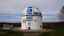

In [4]:
img_small = Image.open('r2d2.jpg')
img_small.thumbnail((64, 64)) # resizes image in-place
img_small

matplotlib predefines resolution (default 100 dpi) and figure size (default 6.4 x 4.8 inches) of images (Although in the end you always look at display resolution, so the figure size on your display is different.)

--> resized image (different number of pixels) is shown --> need for interpolation (default interpolation method depends on resizing)

NB: This is just for visualization of the image, the image itself keeps its size.

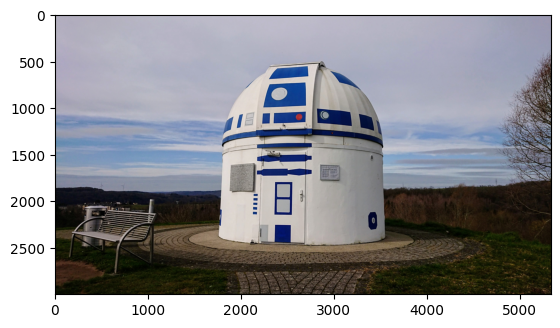

In [5]:
plt.imshow(img_large)

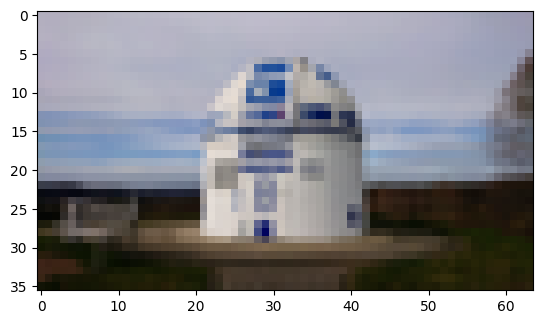

In [6]:
plt.imshow(img_small)

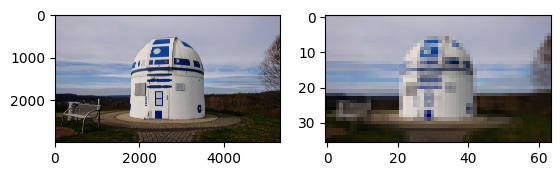

In [7]:
plt.subplot(121)
plt.imshow(img_large)
plt.subplot(122)
plt.imshow(img_small)

simplest interpolation: using nearest neighbors

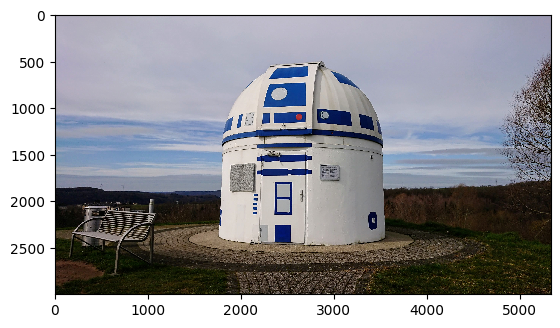

In [8]:
plt.imshow(img_large, interpolation='nearest')

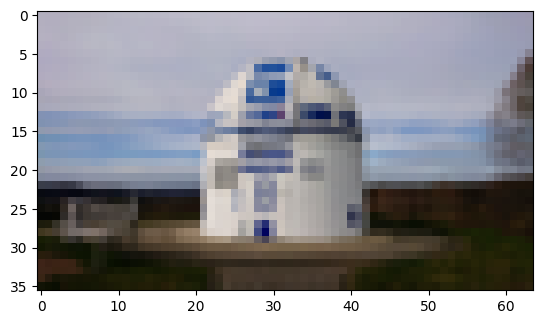

In [9]:
plt.imshow(img_small, interpolation='nearest')

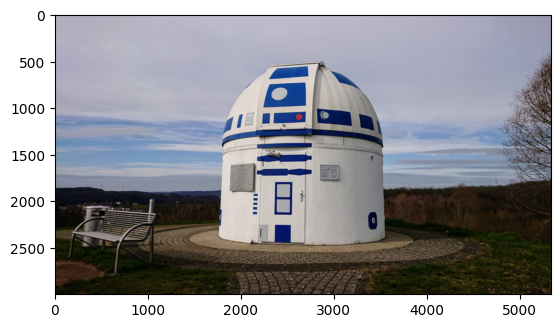

In [10]:
plt.imshow(img_large, interpolation='bilinear')

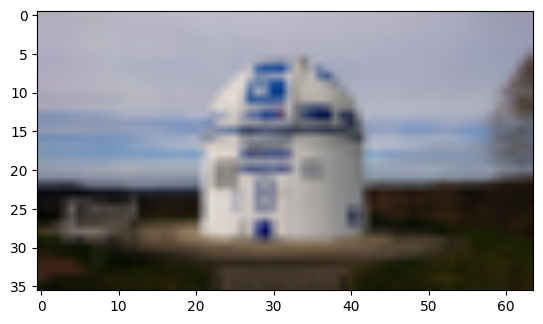

In [11]:
plt.imshow(img_small, interpolation='bilinear')

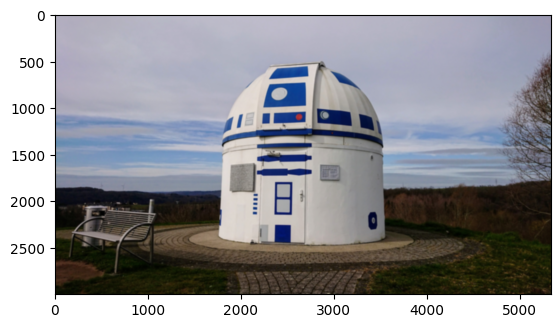

In [12]:
plt.imshow(img_large, interpolation='bicubic')

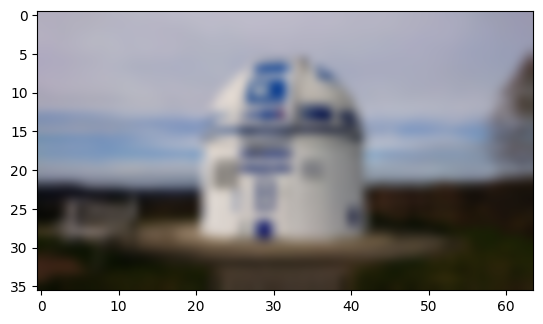

In [13]:
plt.imshow(img_small, interpolation='bicubic')

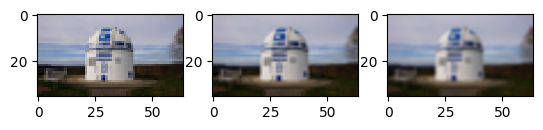

In [14]:
plt.subplot(131)
plt.imshow(img_small, interpolation='nearest')
plt.subplot(132)
plt.imshow(img_small, interpolation='bilinear')
plt.subplot(133)
plt.imshow(img_small, interpolation='bicubic')

in order to show image in native size, need to adjust matplotlib figure size (or resolution) accordingly: 

In [15]:
def plot_native_size(image):
    # dimensions of the image
    height, width, _ = image.shape

    # fix number of pixels (image size) and resolution --> variable figure size
    _, ax = plt.subplots(figsize=(width / 100, height / 100), dpi=100)

    ax.imshow(image)
    ax.axis('off')  # hide the axes

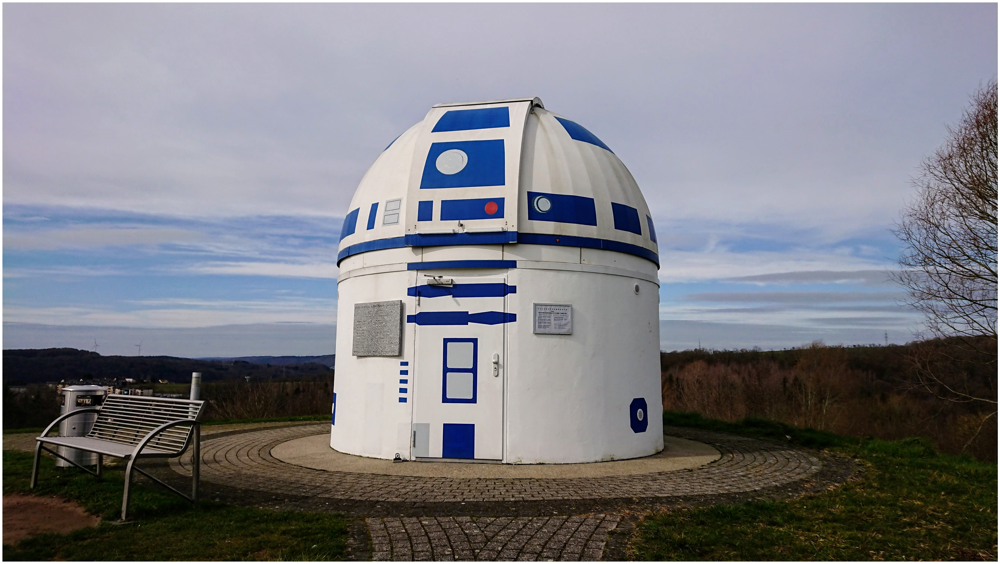

In [16]:
r2d2 = cv2.imread('r2d2.jpg')
r2d2 = cv2.cvtColor(r2d2, cv2.COLOR_BGR2RGB)

plot_native_size(r2d2)

In [17]:
r2d2.shape

(3000, 5333, 3)

actually resize the image

In [18]:
# define new dimensions
width = r2d2.shape[1] // 20
height = r2d2.shape[0] // 20
dim = (width, height)

r2d2_resized = cv2.resize(r2d2, dim, interpolation=cv2.INTER_CUBIC)

r2d2_resized.shape

(150, 266, 3)

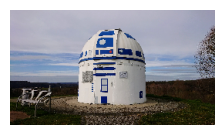

In [19]:
plot_native_size(r2d2_resized)

even better for downsampling (moire-free results):

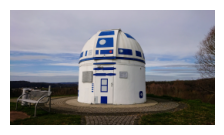

In [20]:
r2d2_resized = cv2.resize(r2d2, dim, interpolation=cv2.INTER_AREA)
plot_native_size(r2d2_resized)